## Objetivo: Mostrar o funcionamento da rede neural com imagens de teste.

Passo 1: Imports, definições de caminhos, classes e funções utilizadas pelo programa

In [5]:
# Imports necessários
import os
import PIL
import math
import numpy as np

import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers
from tensorflow.keras.preprocessing.image import load_img
from tensorflow.keras.preprocessing.image import array_to_img
from tensorflow.keras.preprocessing.image import img_to_array
from tensorflow.keras.preprocessing import image_dataset_from_directory

from IPython.display import display


def constroi_modelo(upscale_factor=3, channels=1):
    conv_args = {
        "activation": "relu",
        "kernel_initializer": "Orthogonal",
        "padding": "same",
    }
    inputs = keras.Input(shape=(None, None, channels))
    x = layers.Conv2D(64, 5, **conv_args)(inputs)
    x = layers.Conv2D(64, 3, **conv_args)(x)
    x = layers.Conv2D(32, 3, **conv_args)(x)
    x = layers.Conv2D(channels * (upscale_factor ** 2), 3, **conv_args)(x)
    outputs = tf.nn.depth_to_space(x, upscale_factor)
    
    model = keras.Model(inputs, outputs)
    
    loss_fn = keras.losses.MeanSquaredError()
    optimizer = keras.optimizers.Adam(learning_rate=0.001)
    model.compile(
        optimizer=optimizer, loss=loss_fn,
    )
    return model


def conversor_alta_resolucao(modelo, img):
    ycbcr = img.convert("YCbCr")
    img_cinza, canal_cb, canal_cr = ycbcr.split()
    img_cinza = img_to_array(img_cinza)
    img_cinza = img_cinza.astype("float32") / 255.0

    entrada = np.expand_dims(img_cinza, axis=0)
    saida = modelo.predict(entrada)

    saida_img_cinza = saida[0]
    saida_img_cinza *= 255.0

    saida_img_cinza = saida_img_cinza.clip(0, 255)
    saida_img_cinza = saida_img_cinza.reshape(
        (np.shape(saida_img_cinza)[0], 
         np.shape(saida_img_cinza)[1])
    )

    saida_img_cinza = PIL.Image.fromarray(np.uint8(saida_img_cinza), mode="L")
    saida_canal_cb = canal_cb.resize(saida_img_cinza.size, PIL.Image.BICUBIC)
    saida_canal_cr = canal_cr.resize(saida_img_cinza.size, PIL.Image.BICUBIC)
    img_resultado = PIL.Image.merge("YCbCr", 
            (saida_img_cinza, saida_canal_cb, saida_canal_cr)).convert(
        "RGB"
    )
    return img_resultado


def abreImagem(nome):
    return PIL.Image.open(os.path.join(r"/home/dangelo/Downloads", nome))


def printImagem(modelo, nome):
    imgBaixa = abreImagem(nome)
    display(imgBaixa)
    
    imgAlta = conversor_alta_resolucao(modelo, imgBaixa)
    display(imgAlta)
    
    print(f"Imagem baixa: {imgBaixa.size[0], imgBaixa.size[1]}")
    print(f"Imagem alta: {imgAlta.size[0], imgAlta.size[1]}")
    

# Pasta com os checkpoints
PASTA_CHECKPOINT: str = r"/home/dangelo/dev/TCC/image-resolution/src/criacao_modelo/checkpoint_100_epocas"
ARQUIVO_CHECKPOINT: str = os.path.join(PASTA_CHECKPOINT, "meu-checkpoint")

Passo 2: Construir o modelo e carregar os pesos

In [2]:
# Construindo o modelo
modelo = constroi_modelo(upscale_factor=3, channels=1)
modelo.load_weights(ARQUIVO_CHECKPOINT)
modelo.summary()

Model: "model"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         [(None, None, None, 1)]   0         
_________________________________________________________________
conv2d (Conv2D)              (None, None, None, 64)    1664      
_________________________________________________________________
conv2d_1 (Conv2D)            (None, None, None, 64)    36928     
_________________________________________________________________
conv2d_2 (Conv2D)            (None, None, None, 32)    18464     
_________________________________________________________________
conv2d_3 (Conv2D)            (None, None, None, 9)     2601      
_________________________________________________________________
tf.nn.depth_to_space (TFOpLa (None, None, None, 1)     0         
Total params: 59,657
Trainable params: 59,657
Non-trainable params: 0
_________________________________________________________

2021-08-19 19:19:49.070918: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcuda.so.1'; dlerror: libcuda.so.1: cannot open shared object file: No such file or directory
2021-08-19 19:19:49.070941: W tensorflow/stream_executor/cuda/cuda_driver.cc:326] failed call to cuInit: UNKNOWN ERROR (303)
2021-08-19 19:19:49.070960: I tensorflow/stream_executor/cuda/cuda_diagnostics.cc:156] kernel driver does not appear to be running on this host (dangelo-mint): /proc/driver/nvidia/version does not exist
2021-08-19 19:19:49.071203: I tensorflow/core/platform/cpu_feature_guard.cc:142] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.


Passo 3: Testar o modelo

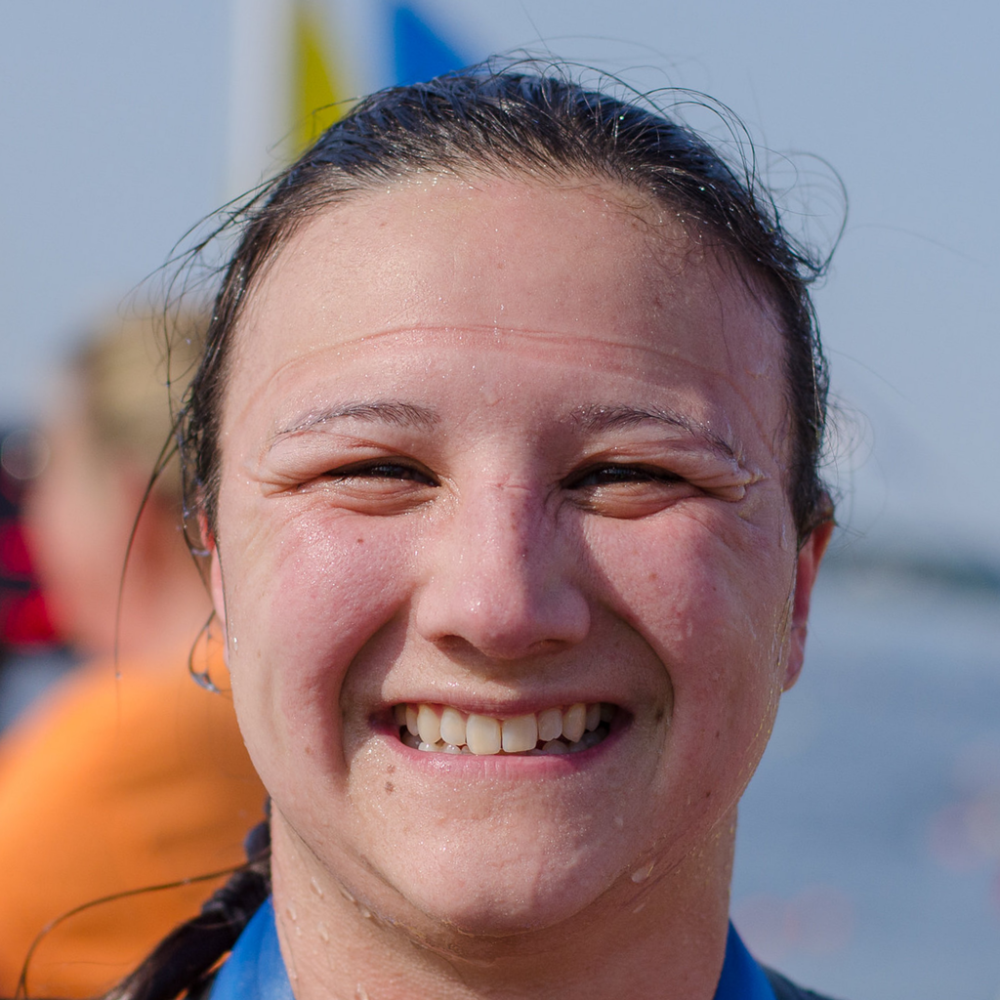

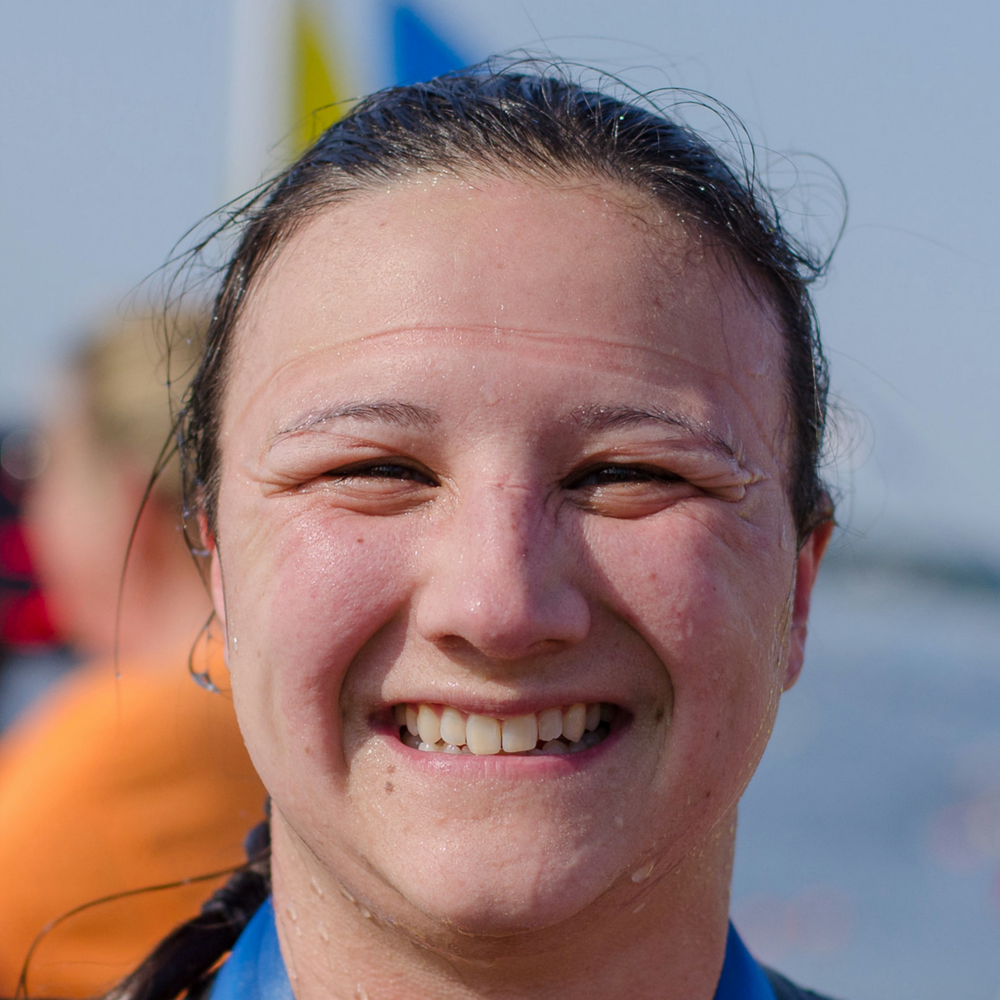

Imagem baixa: (1024, 1024)
Imagem alta: (3072, 3072)


In [6]:
# Teste 1: 30000.png
printImagem(modelo=modelo, nome="30000.png")

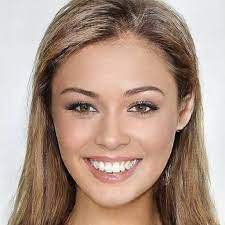

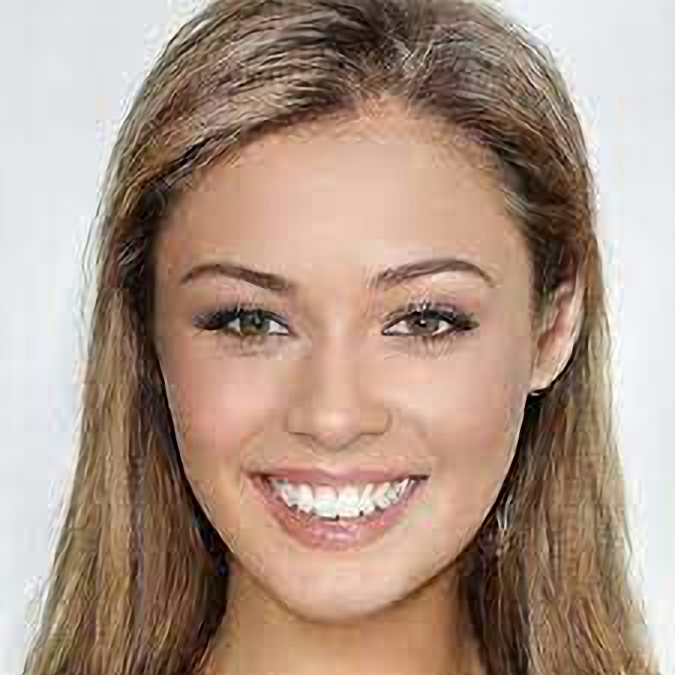

Imagem baixa: (225, 225)
Imagem alta: (675, 675)


In [8]:
# Teste 2: mulher2.jpeg
printImagem(modelo, "mulher2.jpeg")

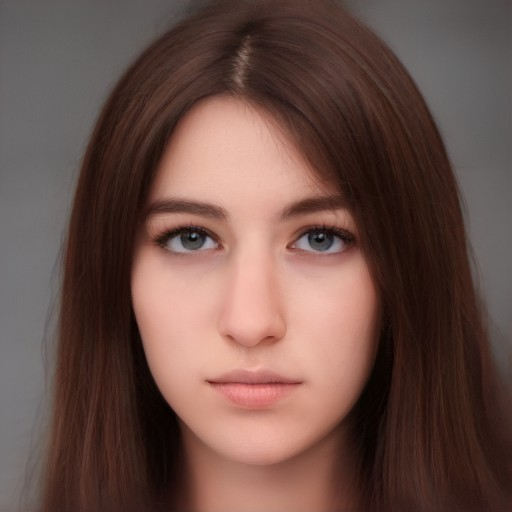

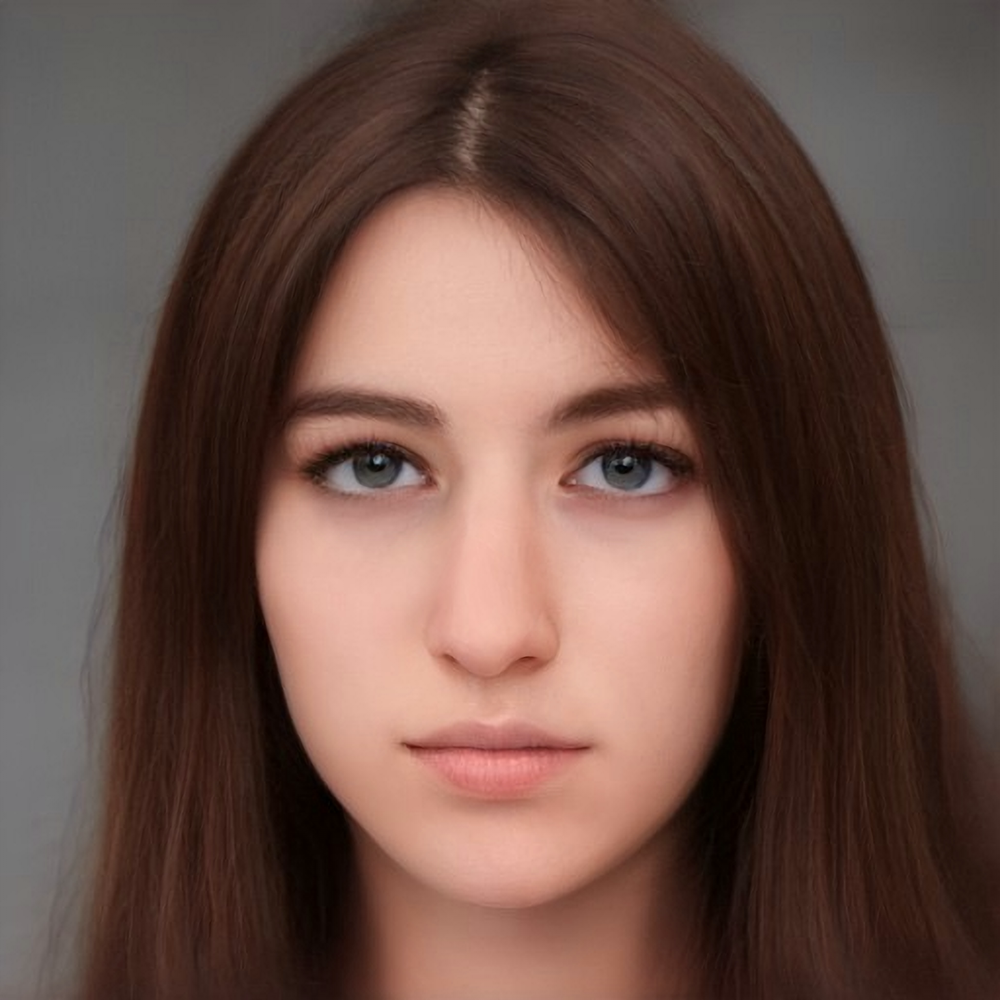

Imagem baixa: (512, 512)
Imagem alta: (1536, 1536)


In [9]:
# Teste 3: mulher3.png
printImagem(modelo, "mulher3.png")

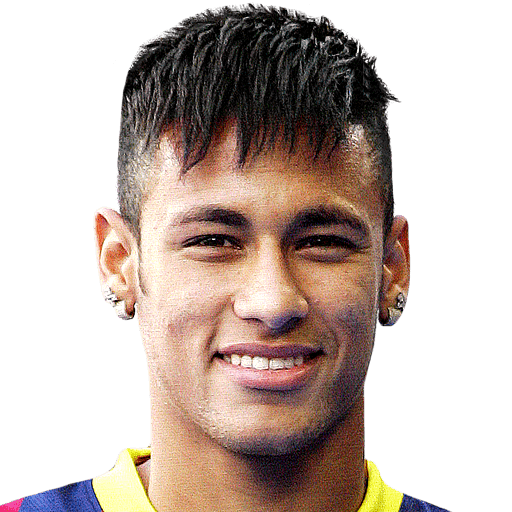

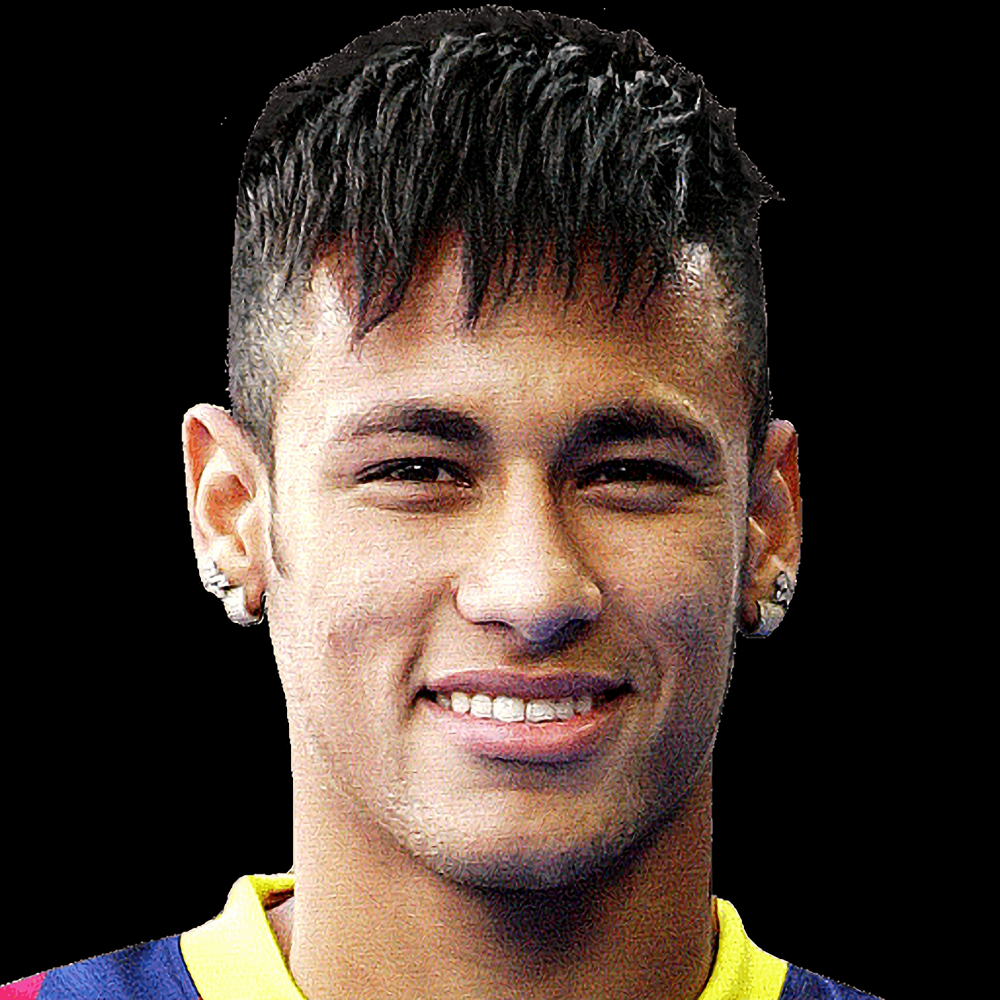

Imagem baixa: (512, 512)
Imagem alta: (1536, 1536)


In [10]:
# Teste 4: neymar.png
printImagem(modelo, "neymar.png")

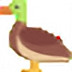

Imagem baixa: (24, 24)
Imagem alta: (72, 72)


In [11]:
# Teste 5: duck.png
printImagem(modelo, "duck.png")

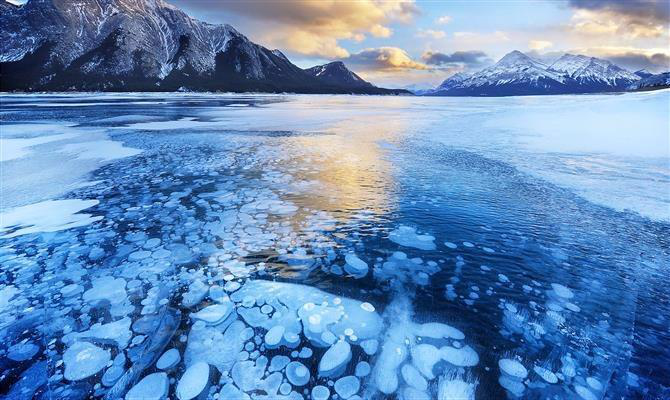

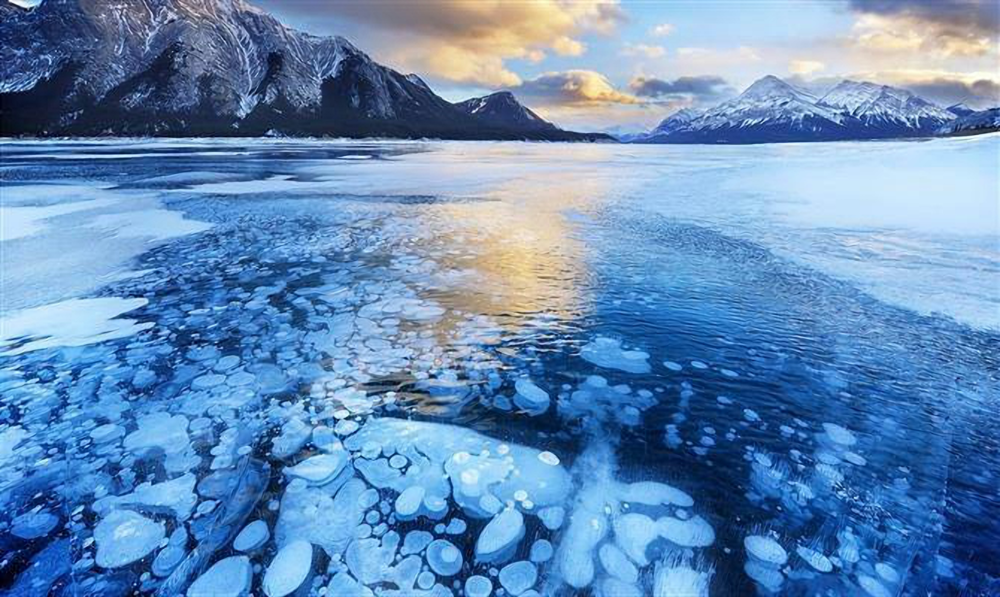

Imagem baixa: (670, 400)
Imagem alta: (2010, 1200)


In [12]:
# Teste 6: Paisagem1
printImagem(modelo, "paisagem1.jpg")

In [13]:
paisagem1 = abreImagem("paisagem1.jpg")

In [14]:
paisagem1Aumentada = conversor_alta_resolucao(modelo, paisagem1)

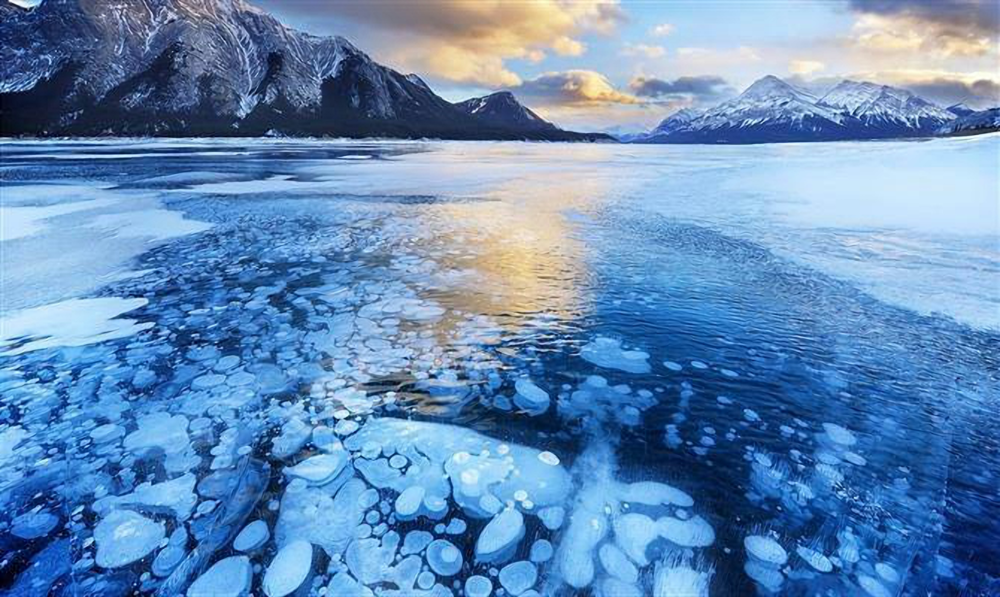

In [15]:
display(paisagem1Aumentada)